In [1]:
import click
import logging
import json
import pickle
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
from torchvision import datasets
from torch.utils.data import DataLoader
from pathlib import Path
from functools import partial


In [2]:
MUL_PANSHARPEN_IMGS = "../data/processed/train/data/MUL-PanSharpen/MUL-PanSharpen"
MUL_PANSHARPEN_TEST = "../data/processed/test/MUL-PanSharpen"
BUILDING_FOLDER = "../data/processed/train/buildings"
MODEL_FOLDER = "../models"
INFO_FOLDER = "../data/raw/train/info"
INFO_CSV = "../data/processed/train/Building_Solutions.csv"
REPORT_FOLDER = "../reports/figures"
MUL_PANSHARPEN_MEAN_STD_JSON = "../data/processed/stats_mul_pan.json"
MUL_PANSHARPEN_RESULTS = "../reports/results_mul_pansharpen.pkl"
BATCH_SIZE = 8
OPT_BATCH_SIZE = 32
EPOCHS = 50
DEVICE = "cuda:0"

UNET_MODEL = "../models/unet_model"
UNET_TEST_MUL = "../test_mulpan_unet"

In [3]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=8, out_channels=2, init_features=32, pretrained=False)

optimizer = optim.Adam(model.parameters(), lr=1e-3)

Using cache found in /home/jupyter/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [4]:
chkpt_folder = Path(MODEL_FOLDER) / 'checkpoints'

In [5]:
!ls -lart {chkpt_folder}

total 4737620
-rw-r--r-- 1 jupyter jupyter 93282325 Feb 12 11:36 tiramisu_chkpt_epoch_000.pt
-rw-r--r-- 1 jupyter jupyter 93282773 Feb 12 12:44 tiramisu_chkpt_epoch_001.pt
drwxr-xr-x 2 jupyter jupyter     4096 Feb 12 13:20 .
drwxr-xr-x 3 jupyter jupyter     4096 Feb 12 13:20 ..
-rw-r--r-- 1 jupyter jupyter 93299989 Feb 14 14:01 unet_chkpt_epoch_042.pt
-rw-r--r-- 1 jupyter jupyter 93300373 Feb 14 15:09 unet_chkpt_epoch_043.pt
-rw-r--r-- 1 jupyter jupyter 93300821 Feb 14 16:17 unet_chkpt_epoch_044.pt
-rw-r--r-- 1 jupyter jupyter 93301205 Feb 14 17:25 unet_chkpt_epoch_045.pt
-rw-r--r-- 1 jupyter jupyter 93301653 Feb 14 18:33 unet_chkpt_epoch_046.pt
-rw-r--r-- 1 jupyter jupyter 93302037 Feb 14 19:41 unet_chkpt_epoch_047.pt
-rw-r--r-- 1 jupyter jupyter 93302485 Feb 14 20:49 unet_chkpt_epoch_048.pt
-rw-r--r-- 1 jupyter jupyter 93302869 Feb 14 21:57 unet_chkpt_epoch_049.pt
-rw-r--r-- 1 jupyter jupyter 93282325 Feb 21 11:34 unet_chkpt_epoch_000.pt
-rw-r--r-- 1 jupyter jupyter 93282773 Feb 21 1

In [6]:
latest_model = chkpt_folder / 'unet_chkpt_epoch_041.pt'

checkpoint = torch.load(latest_model)
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
results = checkpoint['results']

model.eval()

UNet(
  (encoder1): Sequential(
    (enc1conv1): Conv2d(8, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (enc1norm1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (enc1relu1): ReLU(inplace=True)
    (enc1conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (enc1norm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (enc1relu2): ReLU(inplace=True)
  )
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder2): Sequential(
    (enc2conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (enc2norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (enc2relu1): ReLU(inplace=True)
    (enc2conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (enc2norm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tra

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import torch
from pathlib import Path


def comp_corr_pred(cm: np.ndarray) -> float:
    """Returns the ratio of true positives over the total.
    Estimates how many correct predictions the model did

    Args:
        cm (np.ndarray): confusion matrix of n-size (where n
        is the number of labels)

    Returns:
        float: Number of correct predictions (between 0 and 1)
    """
    m_size, _ = cm.shape
    return (cm * np.identity(m_size)).sum() / cm.sum()


def iou(cm: np.ndarray) -> float:
    return cm[-1, -1] / (cm.sum() - cm[0, 0])


def plot_loss(results: dict, fig_folder: Path) -> None:
    """Shows the evolution of the training and validation loss
    on a line plot.
    The results are saved in a .png file.

    Args:
        results (dict): a dictionary containing the results
        fig_folder (Path): the folder where vizualisations are saved
    """
    fig_folder.mkdir(exist_ok=True)
    fig, ax = plt.subplots(figsize=(12, 6))

    ax.plot(results["train"]["loss"], label="train")
    ax.plot(results["val"]["loss"], label="val")
    ax.set_title("Loss evolution")
    ax.set_xlabel("Epoch")
    ax.set_ylabel("Loss evolution")
    ax.legend()
    fig.savefig(fig_folder / "loss_evolution.png")


def plot_last_cm(results: dict, fig_folder: Path) -> None:
    """Plots the last confusion matrix on a heatmap.
    Results are displayed in percent (%).
    The results are saved in a .png file.

    Args:
        results (dict): a dictionary containing the results
        fig_folder (Path): the folder where vizualisations are saved
    """
    fig_folder.mkdir(exist_ok=True)
    cm_epoch = results["val"]["conf_matrix"]
    last_cm = cm_epoch[-1]
    last_cm /= last_cm.sum()

    fig, ax = plt.subplots(figsize=(22, 14))
    # sns.heatmap(100 * last_cm, vmin=0, vmax=100,
    # center=50, annot=True, ax=ax, fmt='.1f')
    sns.heatmap(100 * last_cm, annot=True, ax=ax, fmt='.1f')
    ax.set_title(f"Last confusion matrix (epoch {len(cm_epoch)})")
    fig.savefig(fig_folder / f"last_cm_epoch_{len(cm_epoch)}.png")


def plot_correct_preds(results: dict, fig_folder: Path) -> None:
    """Shows the evolution of the correct predictions made on a
    line plot.
    The results are saved in a .png file.

    Args:
        results (dict): a dictionary containing the results
        fig_folder (Path): the folder where vizualisations are saved
    """
    fig_folder.mkdir(exist_ok=True)
    cm_epoch = results["val"]["conf_matrix"]
    corr_pred = np.array([comp_corr_pred(cm) for cm in cm_epoch])

    fig, ax = plt.subplots(figsize=(12, 6))
    ax.plot(corr_pred)
    ax.set_xlabel("Epoch")
    ax.set_ylabel("Correct preds")
    ax.set_title("N° of correct preds")
    fig.savefig(fig_folder / "corr_preds.png")


def plot_accuracy(results: dict, fig_folder: Path) -> None:
    """Plots evolution of accuracy during training.

    Args:
        results (dict): a dictionary containing the results
        fig_folder (Path): the folder where vizualisations are saved
    """
    fig_folder.mkdir(exist_ok=True)
    fig, ax = plt.subplots(figsize=(12, 6))

    ax.plot(results["train"]["accuracy"], label="train")
    ax.plot(results["val"]["accuracy"], label="val")
    ax.set_title("Accuracy evolution")
    ax.set_xlabel("Epoch")
    ax.set_ylabel("Accuracy")
    ax.legend()
    fig.savefig(fig_folder / "accuracy_evolution.png")


def plot_iou(results: dict, fig_folder: Path) -> None:
    """Shows the evolution of the intersection over union ratio.
    The results are saved in a .png file.

    Args:
        results (dict): a dictionary containing the results
        fig_folder (Path): the folder where vizualisations are saved
    """
    fig_folder.mkdir(exist_ok=True)
    cm_epoch = results["val"]["conf_matrix"]
    corr_pred = np.array([iou(cm) for cm in cm_epoch])

    fig, ax = plt.subplots(figsize=(12, 6))
    ax.plot(corr_pred)
    ax.set_xlabel("Epoch")
    ax.set_ylabel("IoU")
    ax.set_title("Evolution of IoU")
    fig.savefig(fig_folder / "iou.png")


def generate_masks(ds, model, fig_folder, slot_number, n_samples):
    fig_folder.mkdir(exist_ok=True)
    train_mask_folder = fig_folder / 'train_masks'
    train_mask_folder.mkdir(exist_ok=True)
    
    random_idx = np.random.choice(len(ds), size=n_samples)
    imgs = []
    masks = []
    
    for i in random_idx:
        img, mask_img = ds[i]
        imgs.append(img)
        masks.append(mask_img)
    
    imgs, masks = torch.stack(imgs), torch.stack(masks)
    
    with torch.no_grad():
        pred = model(imgs)
        
    n_rows = pred.shape[0]
    n_cols = 4

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(12, 18))
    fig.suptitle('Image, mask, probabilities and predictions', fontsize=12)

    for i_row, axrow in enumerate(axs):
        img_rgb = imgs[i_row, [4, 2, 1], :650, :650].numpy()
        img_rgb = np.transpose(img_rgb, axes=(1, 2, 0))
        img_rgb = (img_rgb - img_rgb.min()) / (img_rgb.max() - img_rgb.min())
        
        axrow[0].imshow(img_rgb)
        axrow[1].imshow(masks[i_row, :650, :650].numpy())
        axrow[2].imshow(pred[i_row, 1, :650, :650].numpy())
        axrow[3].imshow(pred.argmax(dim=1)[i_row, :650, :650].numpy())
    
    fig.savefig(fig_folder / f"unet_mask_results_{slot_number}.png")
    
    

In [8]:

import numpy as np
import pandas as pd
import rasterio
from rasterio.mask import mask
from tqdm import tqdm
import json
import fiona
import torch
from pathlib import Path
from torch.utils.data import random_split, Dataset
from typing import Tuple


log_fmt = '%(asctime)s - %(name)s - %(levelname)s - %(message)s'
logging.basicConfig(level=logging.INFO, format=log_fmt)
logger = logging.getLogger('model_utils_dataset')


class MulPanSharpenDataset(Dataset):
    def __init__(self, image_folder,
                 building_folder,
                 csv_data,
                 transforms=None):
        self.image_folder = image_folder
        self.building_folder = building_folder
        self.csv_data = csv_data
        self.transforms = transforms
        self.label = "MUL-PanSharpen"
    
    def __len__(self):
        return len(list(self.image_folder.iterdir()))
    
    def __getitem__(self, idx):
        file_img = list(self.image_folder.iterdir())[idx]
        
        img_id = "_".join(file_img.stem.split("_")[1:])
        no_building = self.csv_data[self.csv_data['BuildingId'] == -1]['ImageId'].unique().tolist()
        geojson_path = self.building_folder / f"buildings_{img_id}.geojson"

        # Extract the file as a (8 x 650 x 650) cube
        with rasterio.open(file_img) as tif:
            arr = tif.read()
            info = tif.meta
        
        info['count'] = 1
        # Extract geofeatures if the image has buildings
        if img_id in no_building:
            X = np.zeros((info['height'], info['width']), dtype='uint16')
            features = []
        else:
            with fiona.open(geojson_path, "r") as geojson:
                features = [feature["geometry"] for feature in geojson]
            X = np.ones((info['height'], info['width']), dtype='uint16')

        # Write polygons as a tif whose dimensions are the same than the opened tif
        with rasterio.open('temp.tif', 'w', **info) as new_ds:
            new_ds.write(X, 1)
        
        # Extract mask if necessary
        with rasterio.open('temp.tif') as tif:
            if features:
                mask_img, _ = mask(tif, features)
            else:
                mask_img = tif.read()

        arr = torch.from_numpy(arr.astype(np.int16)).float()
        mask_img = torch.from_numpy(mask_img.astype(np.int64)).long()
        
        if self.transforms:
            arr, mask_img = self.transforms(arr, mask_img)

        Path('temp.tif').unlink()

        return arr, mask_img.squeeze(0)

In [9]:
import torch.nn as nn
import torchvision.transforms as T
import torchvision.transforms.functional as TF
import numpy as np


class SemSegCompose(nn.Module):
    def __init__(self, padding, mean_ch, std_ch, angle):
        super().__init__()
        self.pad = T.Pad(padding)
        self.norm = T.Normalize(mean_ch, std_ch)
        self.angle = angle
        
    def forward(self, img, mask_img):
        img, mask_img = self.pad(img), self.pad(mask_img)
        
        # random vertical flip
        if np.random.random() > 0.5:
            img, mask_img = TF.vflip(img), TF.vflip(mask_img)
            
        # random horizontal flip
        if np.random.random() > 0.5:
            img, mask_img = TF.hflip(img), TF.hflip(mask_img)
        
        # random rotation
        if np.random.random() > 0.5:
            angle = np.random.randint(-self.angle, self.angle)
            img, mask_img = TF.rotate(img, angle), TF.rotate(mask_img, angle)
            
        img = self.norm(img)
        return img, mask_img

## recreate dataset

In [10]:
df = pd.read_csv('../data/processed/train/Building_Solutions.csv')
with open('../data/processed/stats_mul_pan.json') as file:
    stats = json.load(file)
    
mean_channels = stats["mean"]
std_channels = stats["std"]

image_folder = Path(MUL_PANSHARPEN_IMGS)
building_folder = Path('../data/processed/train/buildings')

img_pad = (3,3,3,3)

transforms = SemSegCompose(img_pad, mean_channels, std_channels, 360)
ds = MulPanSharpenDataset(image_folder,
                          building_folder,
                          df,
                          transforms=transforms)

In [11]:
figure_folder = Path(REPORT_FOLDER)

# plot_loss(results, figure_folder)
# print("Loss curve created.")

# plot_last_cm(results, figure_folder)
# print("Last confusion matrix created")

# plot_correct_preds(results, figure_folder)
# print("Evolution of correct predictions created;")

# plot_accuracy(results, figure_folder)
# print("Accuracy plot created.")

# plot_iou(results, figure_folder)
# print("IoU evolution plot created.")

# for i in range(5):
#     generate_masks(ds, model, figure_folder, i, 5)
# print("Created model results.")

In [12]:
class MulPanSharpenTestDataset(Dataset):
    def __init__(self, image_folder,
                 transforms=None):
        self.image_folder = image_folder
        self.transforms = transforms
        self.label = "MUL-PanSharpen"
    
    def __len__(self):
        return len(list(self.image_folder.iterdir()))
    
    def __getitem__(self, idx):
        file_img = list(self.image_folder.iterdir())[idx]

        # Extract the file as a (8 x 650 x 650) cube
        with rasterio.open(file_img) as tif:
            arr = tif.read()

        arr = torch.from_numpy(arr.astype(np.int16)).float()
        
        if self.transforms:
            arr = self.transforms(arr)

        return arr

In [13]:
test_folder =  Path(MUL_PANSHARPEN_TEST)

test_ds = MulPanSharpenTestDataset(test_folder, transforms=T.Compose([T.Pad(img_pad), T.Normalize(mean_channels, std_channels)]))
len(test_ds)

3526

In [14]:


test_dl = DataLoader(test_ds, batch_size=4)

test_result_folder = figure_folder / 'test_masks'
test_result_folder.mkdir(exist_ok=True)
test_name = "MulPanSharpen"

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


RuntimeError: [enforce fail at CPUAllocator.cpp:65] . DefaultCPUAllocator: can't allocate memory: you tried to allocate 220332032 bytes. Error code 12 (Cannot allocate memory)

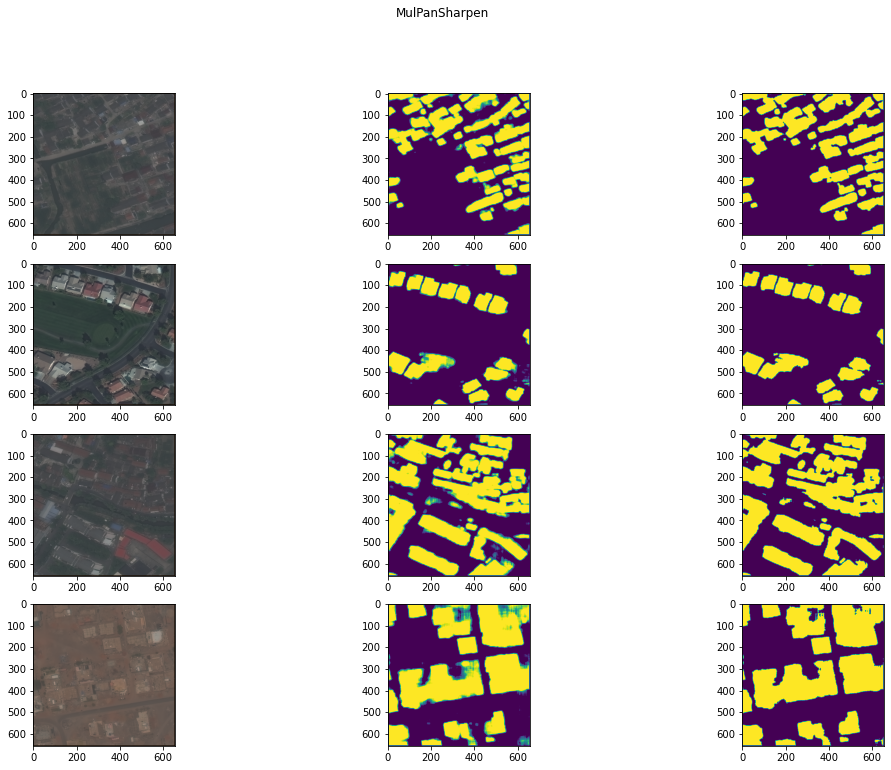

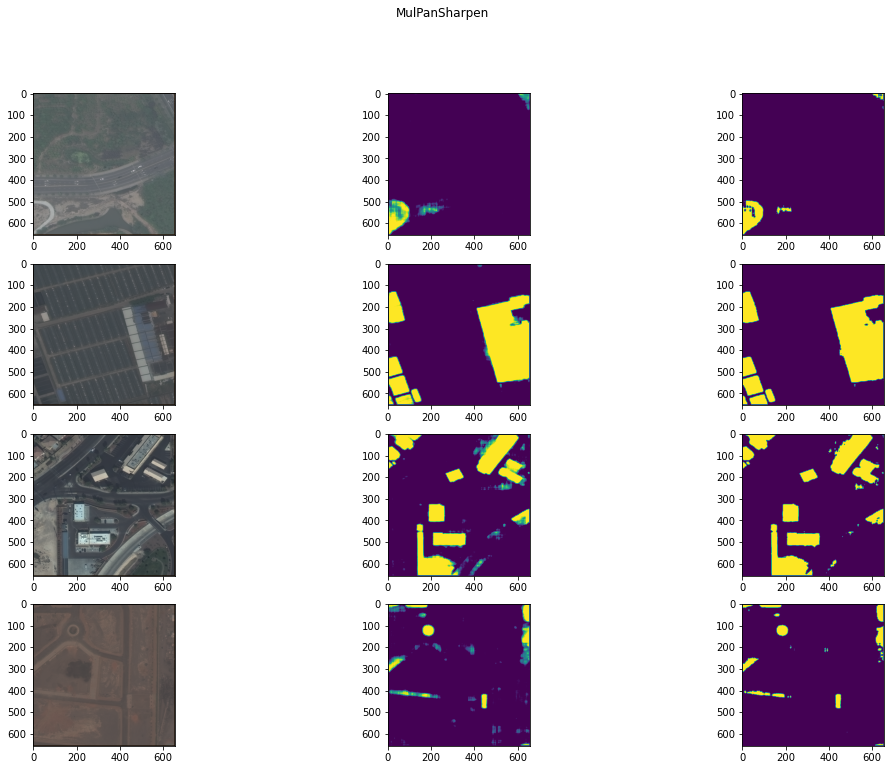

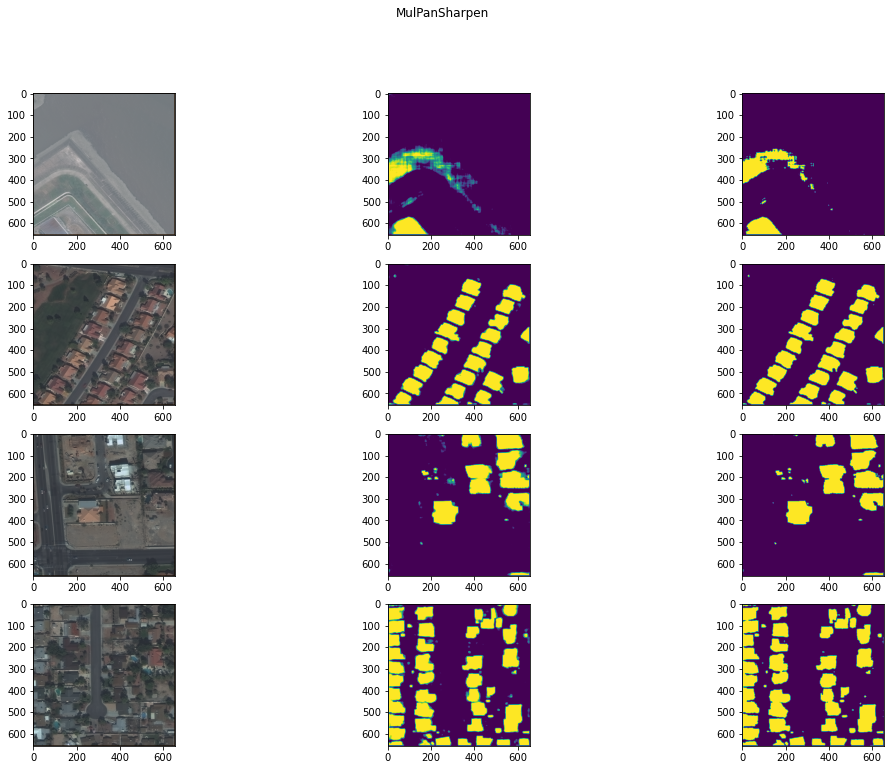

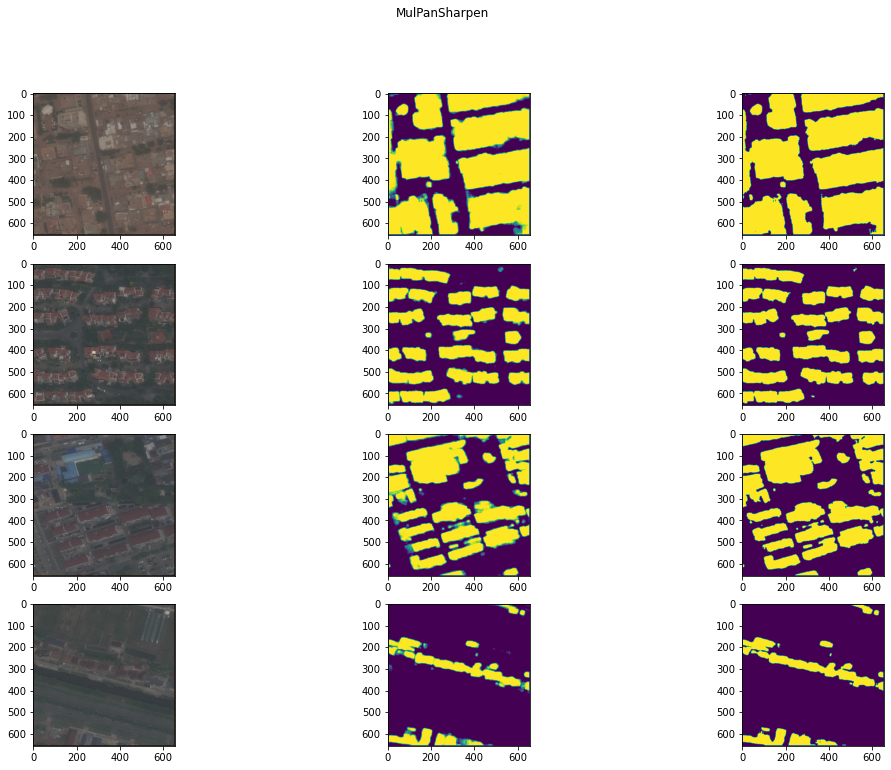

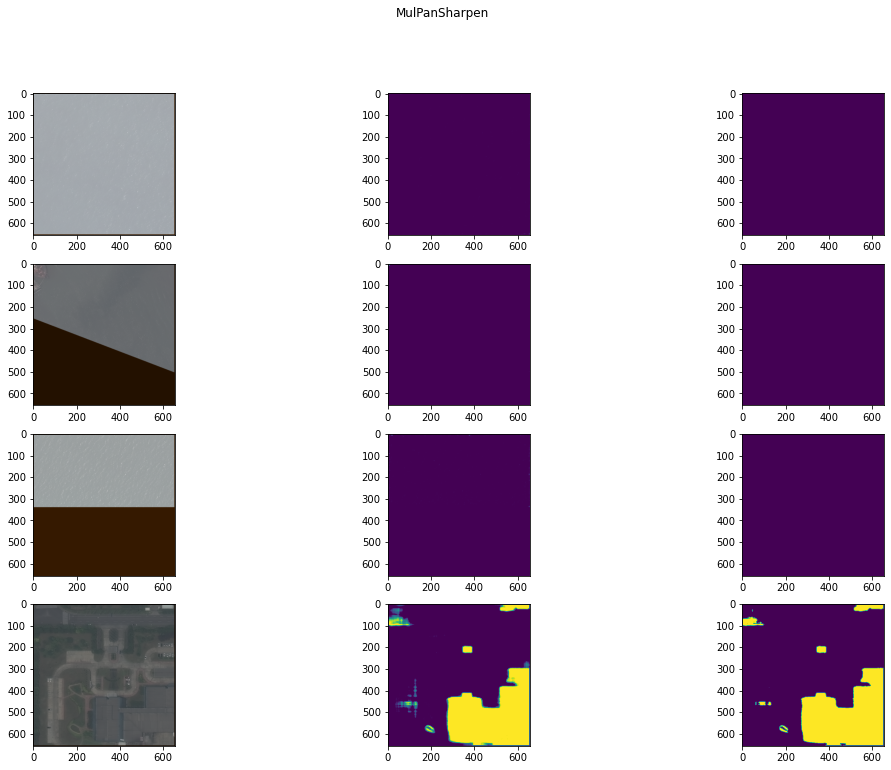

...

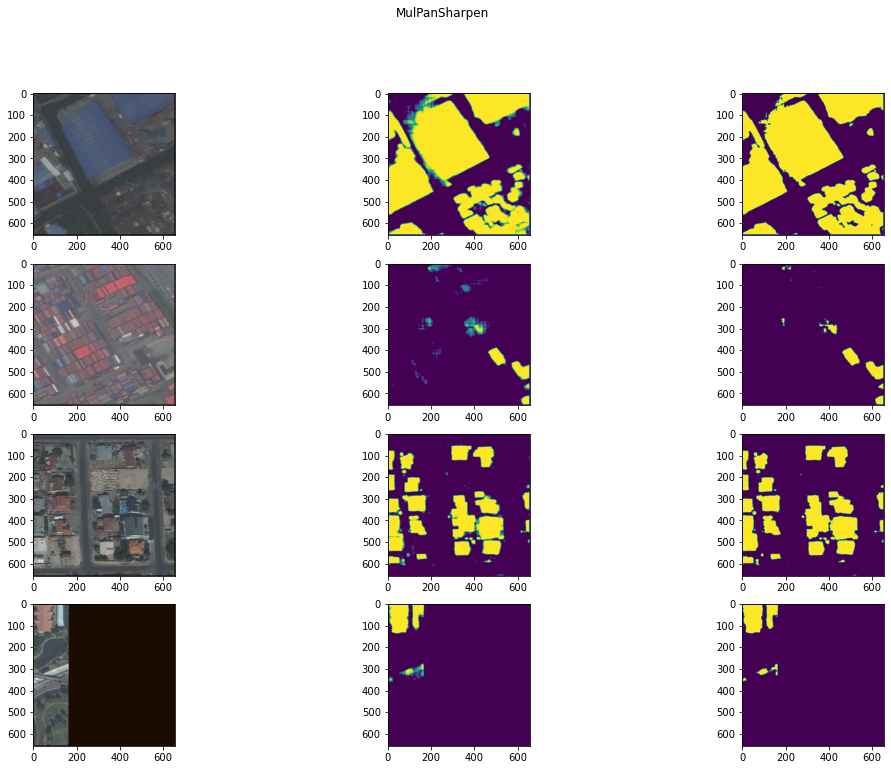

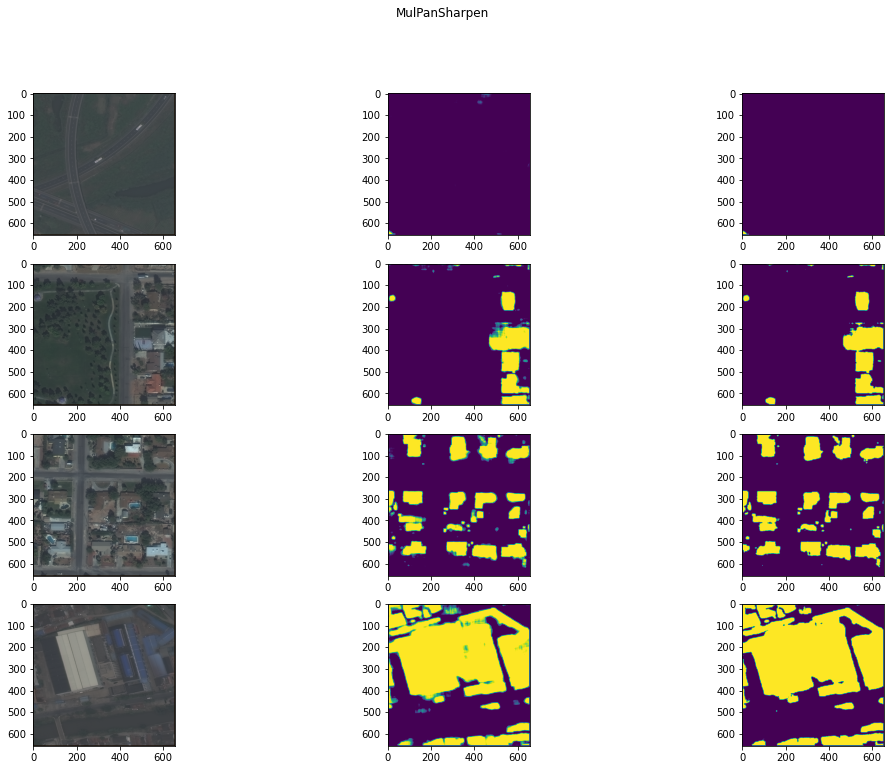

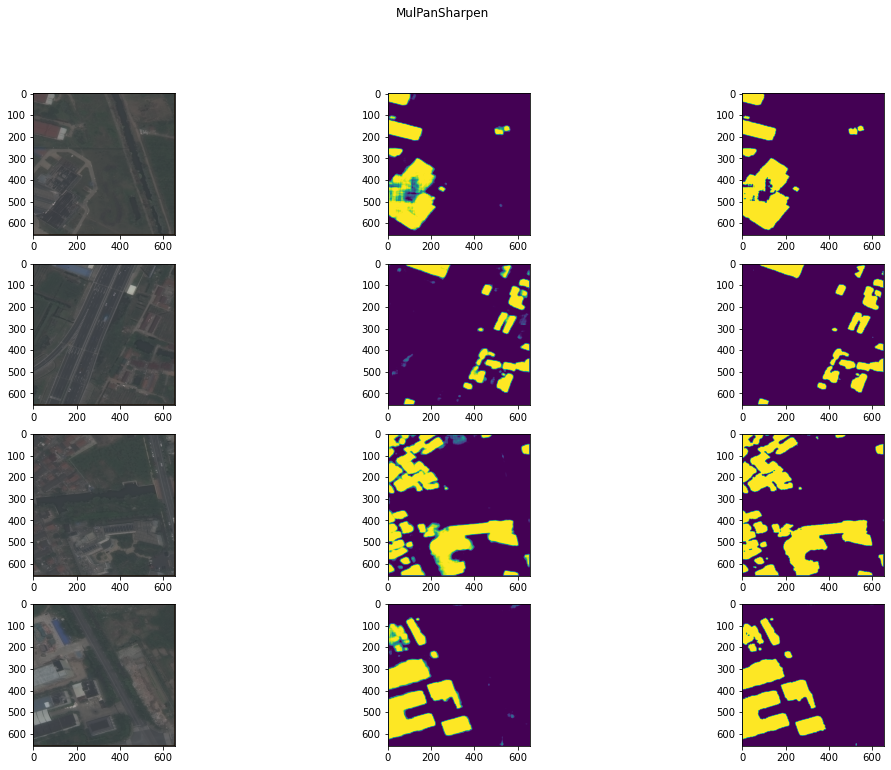

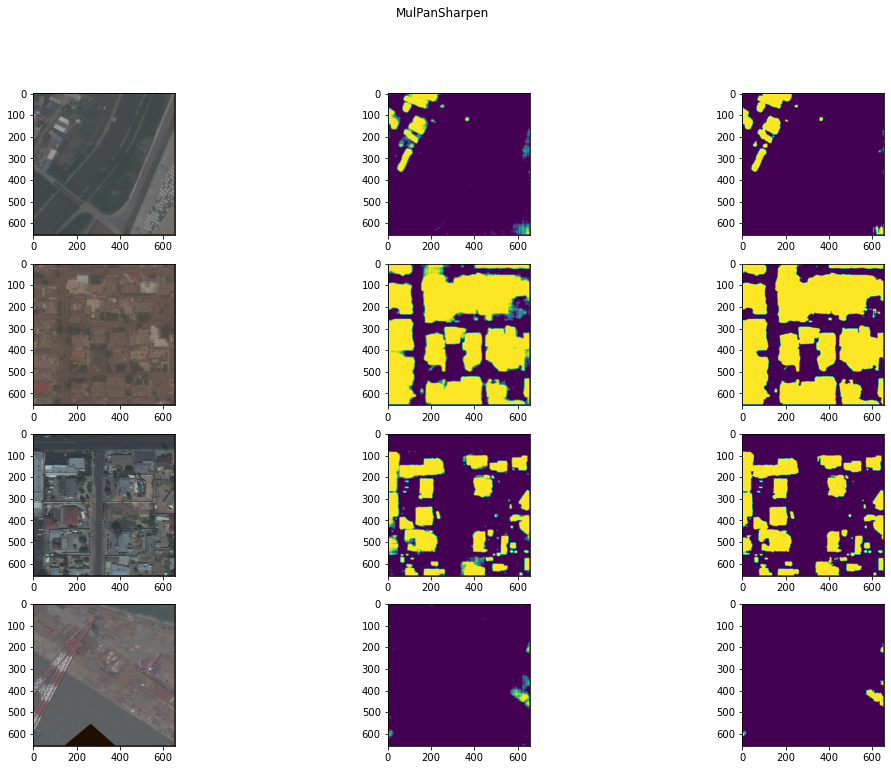

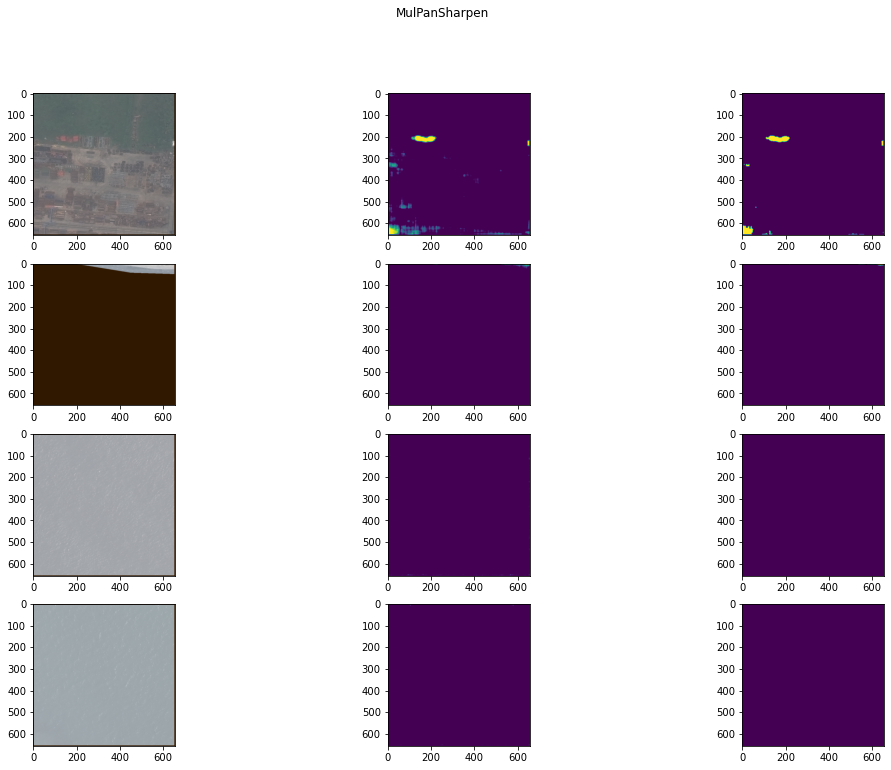

In [ ]:
# Begin figure

for bn, test_img in enumerate(test_dl):
    nrows, n_ch, h, w = test_img.shape
    fig, axs = plt.subplots(nrows, 3, figsize=(18, 12))
    fig.suptitle(f"{test_name}\n")

    # bs, n_ch, h, w
    with torch.no_grad():
        pred_mask = model(test_img)
        
    for i_n, axrow in enumerate(axs):
        img_rgb = test_img[i_n,[4, 2, 1], :h, :w].numpy()
        img_rgb = np.transpose(img_rgb, axes=(1, 2, 0))
        img_rgb = (img_rgb - img_rgb.min()) / (img_rgb.max() 
                                               - img_rgb.min())
        axrow[0].imshow(img_rgb)
        axrow[1].imshow(pred_mask[i_n,1, :h, :w])
        axrow[2].imshow(pred_mask[i_n].argmax(dim=0)[:h, :w].numpy())

    fig.savefig(test_result_folder / f"{test_name}_{bn}.png")